In [29]:
import pandas as pd
import seaborn as sns
import random
import numpy as np
import matplotlib.pyplot as plt
import altair as alt
from wordcloud import WordCloud

In [25]:
df_zomato = pd.read_csv("zomato_restaurants_in_India-1.csv")

df_zomato.head()

,res_id,name,establishment,city,city_id,zipcode,cuisines,average_cost_for_two,price_range,currency,highlights,aggregate_rating,rating_text,votes,photo_count,opentable_support,delivery,takeaway
0,3400299,Bikanervala,['Quick Bites'],Agra,34,NaN,"North Indian, South Indian, Mithai, Street Foo...",700,2,Rs.,"['Lunch', 'Takeaway Available', 'Credit Card',...",4.4,Very Good,814,154,0.0,-1,-1
1,3400005,Mama Chicken Mama Franky House,['Quick Bites'],Agra,34,282001,"North Indian, Mughlai, Rolls, Chinese, Fast Fo...",600,2,Rs.,"['Delivery', 'No Alcohol Available', 'Dinner',...",4.4,Very Good,1203,161,0.0,-1,-1
2,3401013,Bhagat Halwai,['Quick Bites'],Agra,34,282010,"Fast Food, Mithai",300,1,Rs.,"['No Alcohol Available', 'Dinner', 'Takeaway A...",4.2,Very Good,801,107,0.0,1,-1
3,3400290,Bhagat Halwai,['Quick Bites'],Agra,34,282002,"Desserts, Bakery, Fast Food, South Indian",300,1,Rs.,"['Takeaway Available', 'Credit Card', 'Lunch',...",4.3,Very Good,693,157,0.0,1,-1
4,3401744,The Salt Cafe Kitchen & Bar,['Casual Dining'],Agra,34,NaN,"North Indian, Continental, Italian",1000,3,Rs.,"['Lunch', 'Serves Alcohol', 'Cash', 'Credit Ca...",4.9,Excellent,470,291,0.0,1,-1


In [26]:
df_zomato.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 211944 entries, 0 to 211943
Data columns (total 18 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   res_id                211944 non-null  int64  
 1   name                  211944 non-null  object 
 2   establishment         211944 non-null  object 
 3   city                  211944 non-null  object 
 4   city_id               211944 non-null  int64  
 5   zipcode               48757 non-null   object 
 6   cuisines              210553 non-null  object 
 7   average_cost_for_two  211944 non-null  int64  
 8   price_range           211944 non-null  int64  
 9   currency              211944 non-null  object 
 10  highlights            211944 non-null  object 
 11  aggregate_rating      211944 non-null  float64
 12  rating_text           211944 non-null  object 
 13  votes                 211944 non-null  int64  
 14  photo_count           211944 non-null  int64  
 15  

In [4]:
#drop redundant, unnecessary columns or columns with so many null values (like zipcode)
df_zomato.drop(["city_id","zipcode","currency","opentable_support","takeaway","delivery"],axis=1,inplace=True)

df_zomato.columns

Index(['res_id', 'name', 'establishment', 'city', 'cuisines',
       'average_cost_for_two', 'price_range', 'highlights', 'aggregate_rating',
       'rating_text', 'votes', 'photo_count'],
      dtype='object')

In [5]:
df_zomato.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 211944 entries, 0 to 211943
Data columns (total 12 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   res_id                211944 non-null  int64  
 1   name                  211944 non-null  object 
 2   establishment         211944 non-null  object 
 3   city                  211944 non-null  object 
 4   cuisines              210553 non-null  object 
 5   average_cost_for_two  211944 non-null  int64  
 6   price_range           211944 non-null  int64  
 7   highlights            211944 non-null  object 
 8   aggregate_rating      211944 non-null  float64
 9   rating_text           211944 non-null  object 
 10  votes                 211944 non-null  int64  
 11  photo_count           211944 non-null  int64  
dtypes: float64(1), int64(5), object(6)
memory usage: 19.4+ MB


In [6]:
#res_id (restaurant id is the primary key and has so many duplicates (). So, drop the duplicates for this id)

orig_res_id_count = len(df_zomato["res_id"])
uniq_res_id_count = len(df_zomato["res_id"].unique())

uniq_res_id_percentage = uniq_res_id_count/orig_res_id_count * 100

print ("Percentage of unique restaurant ids in overall count = ",np.round(uniq_res_id_percentage,0),"%")

Percentage of unique restaurant ids in overall count =  26.0 %


In [7]:
# Drop duplicate restaurant ids and keep only the first occurence of these ids
df_zomato.drop_duplicates(["res_id"],keep='first',inplace=True)
df_zomato.shape

(55568, 12)

res_id                    0
name                      0
establishment             0
city                      0
cuisines                470
average_cost_for_two      0
price_range               0
highlights                0
aggregate_rating          0
rating_text               0
votes                     0
photo_count               0
dtype: int64

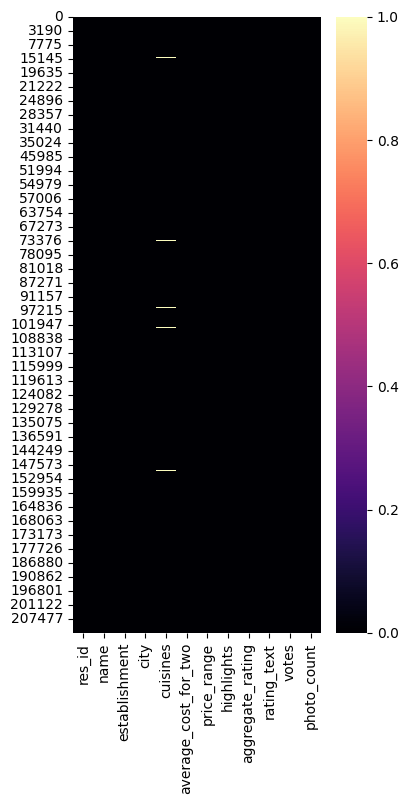

In [8]:
plt.figure(figsize=(4,8))
sns.heatmap(df_zomato.isna(), cmap="magma")

df_zomato.isnull().sum()

Apart from cuisines, all other parameters have values filled in. Since these are few compared to overall, we can remove the same while using the 'cuisines' column for any analysis.

In [9]:
#Count unique values in all columns

n = df_zomato.nunique(axis=0)
print (n)

res_id                  55568
name                    41100
establishment              27
city                       99
cuisines                 9382
average_cost_for_two      145
price_range                 4
highlights              31228
aggregate_rating           33
rating_text                33
votes                    2644
photo_count              2457
dtype: int64


Here, there is only 1 categorical value (price_range). So it makes sense to create more categorical values as categorical values are important for plotting purpose. Below are couple of new columns (metro, rating) added to the table..

<AxesSubplot:title={'center':'Metro vs Non-Metro restaurant counts'}, ylabel='metro'>

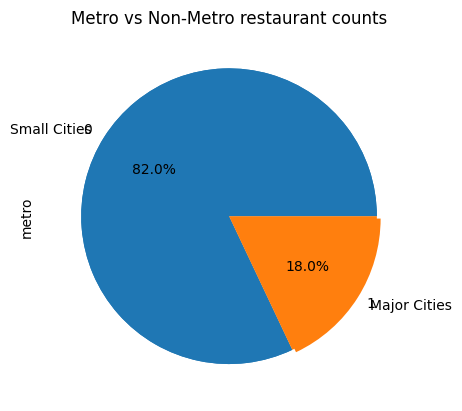

In [10]:
#Create 'metro' categorical value
metro_list=df_zomato.city.isin(["Mumbai","New Delhi","Chennai","Kolkata","Bangalore","Hyderabad"])

df_zomato['metro'] = 0
df_zomato['metro']=np.where(metro_list, 1, 0)

df_zomato.head()
explode = (0, 0.03) 

labels = ["Small Cities","Major Cities"]
metro_counts = df_zomato['metro'].value_counts()

plt.pie(metro_counts, labels=labels, autopct='%1.1f%%',explode=explode)
plt.title("Metro vs Non-Metro restaurant counts")
df_zomato['metro'].value_counts().plot(kind="pie")


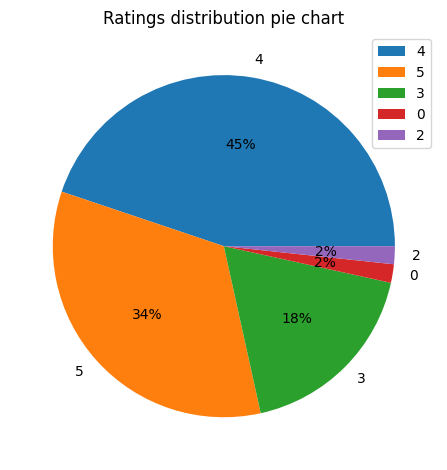

In [11]:
def conditions(s):
    if (s['aggregate_rating'] > 4.5):
        return 5
    if (s['aggregate_rating'] > 3.5) and (s['aggregate_rating'] <= 4.5):
        return 4
    if (s['aggregate_rating'] > 2.5) and (s['aggregate_rating'] <= 3.5):
        return 3
    if (s['aggregate_rating'] > 1.5) and (s['aggregate_rating'] <= 2.5):
        return 2
    if (s['aggregate_rating'] > 0.5) and (s['aggregate_rating'] <= 1.5):
        return 1    
    else:
        return 0

df_zomato["rating"] = df_zomato.apply(conditions, axis=1)

labels = df_zomato['rating'].unique()
rating_counts = df_zomato['rating'].value_counts()

plt.pie(rating_counts, labels=labels, autopct='%.f%%')
plt.title("Ratings distribution pie chart")
plt.tight_layout()
plt.legend()

#ax = df_zomato['rating'].value_counts().plot(kind="pie")
#ax.set_title(" Restaurant ratings pie chart")



(0.0, 32000.0)

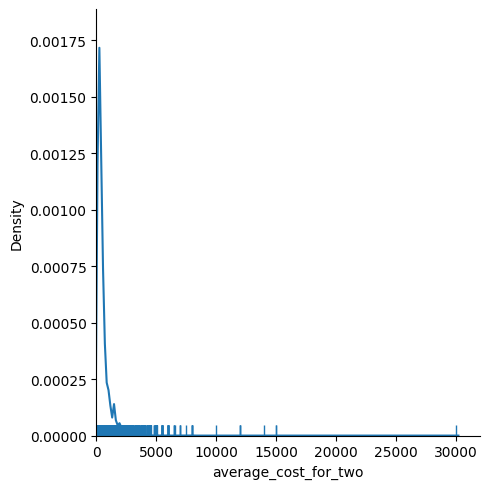

In [12]:
sns.displot(data=df_zomato, x="average_cost_for_two", kind="kde",rug=True)

plt.xlim(0,32000)

In [13]:
if st.checkbox("Show Average Cost distribution"):
    fig1 = plt.figure()
    df_zomato["average_cost_for_two"].plot(kind="kde", xlim=(0,32000))
    #sns.displot(data=df_zomato, x="average_cost_for_two", kind="kde",rug=True)
    #plt.xlim(0,32000)
    st.pyplot(fig1)

NameError: name 'st' is not defined

In [ ]:
df_zomato.to_csv("df_zomato_v1.csv",index=False)

x =pd.read_csv("df_zomato_v1.csv")

x.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55568 entries, 0 to 55567
Data columns (total 14 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   res_id                55568 non-null  int64  
 1   name                  55568 non-null  object 
 2   establishment         55568 non-null  object 
 3   city                  55568 non-null  object 
 4   cuisines              55098 non-null  object 
 5   average_cost_for_two  55568 non-null  int64  
 6   price_range           55568 non-null  int64  
 7   highlights            55568 non-null  object 
 8   aggregate_rating      55568 non-null  float64
 9   rating_text           55568 non-null  object 
 10  votes                 55568 non-null  int64  
 11  photo_count           55568 non-null  int64  
 12  metro                 55568 non-null  int64  
 13  rating                55568 non-null  int64  
dtypes: float64(1), int64(7), object(6)
memory usage: 5.9+ MB


In [ ]:
city_counts = df_zomato.groupby("city").count()["res_id"].sort_values(ascending=False).head(10)
city_counts_df = city_counts.to_frame(name='count')

print (city_counts_df.head)
city_counts_df.index

<bound method NDFrame.head of            count
city            
Bangalore   2247
Mumbai      2022
Pune        1843
Chennai     1827
New Delhi   1704
Jaipur      1395
Kolkata     1361
Ahmedabad   1247
Goa         1150
Lucknow     1135>


Index(['Bangalore', 'Mumbai', 'Pune', 'Chennai', 'New Delhi', 'Jaipur',
       'Kolkata', 'Ahmedabad', 'Goa', 'Lucknow'],
      dtype='object', name='city')

<function matplotlib.pyplot.show(close=None, block=None)>

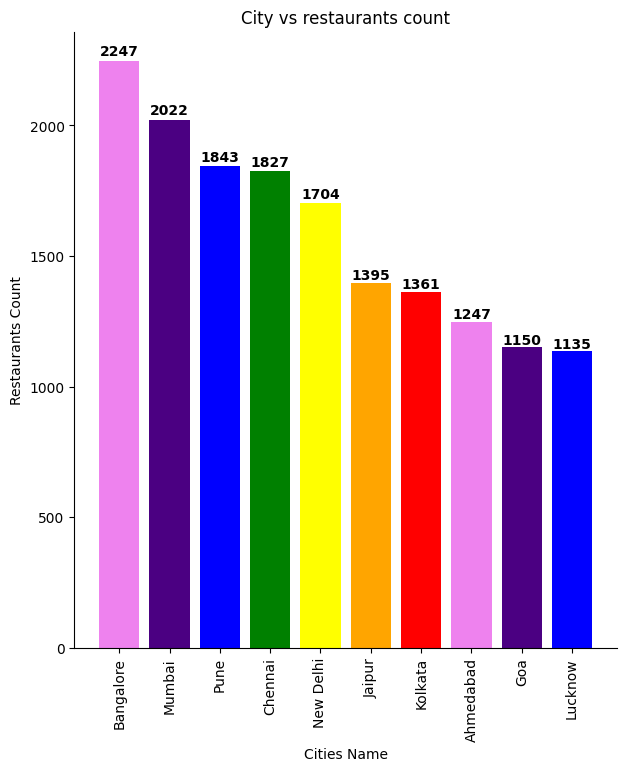

In [ ]:
city_res_counts = df_zomato.groupby("city").count()["res_id"].sort_values(ascending=False).head(10).rename_axis("city").reset_index(name="restaurant_counts")

labels = city_res_counts.city
values = city_res_counts.restaurant_counts

fig = plt.figure(figsize=(7,8))
plt.xlabel("Cities Name")
plt.ylabel("Restaurants Count")

ax = fig.gca()
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)

#Used the VIBGYOR pattern for colors..
colors_list = ["Violet","Indigo","Blue","Green","Yellow","Orange","Red"]

graph = plt.bar(labels,values,color=colors_list)
plt.xticks(rotation=90)
plt.title("City vs restaurants count")

i=0
for p in graph:
    wid = p.get_width()
    ht = p.get_height()
    x,y = p.get_xy()
    plt.text(x+wid/2,y+(ht*1.01),  str(values[i]), ha='center',weight='bold')
    i+=1
    
plt.show


In [18]:
df_zomato_subset = df_zomato[df_zomato.city.isin(["Bangalore","Mumbai","Pune","Chennai","New Delhi","Jaipur","Kolkata","Ahmedabad","Goa","Lucknow"])]
df_zomato_cities = df_zomato_subset.copy()

metro_list=df_zomato_cities.city.isin(["Mumbai","New Delhi","Chennai","Kolkata","Bangalore", "Hyderabad"])

df_zomato_cities['metro'] = 0
df_zomato_cities['metro']=np.where(metro_list, 1, 0)

df_zomato_cities.head()
df_zomato_cities['metro'].value_counts()

print (df_zomato['metro'].value_counts())

0    45585
1     9983
Name: metro, dtype: int64


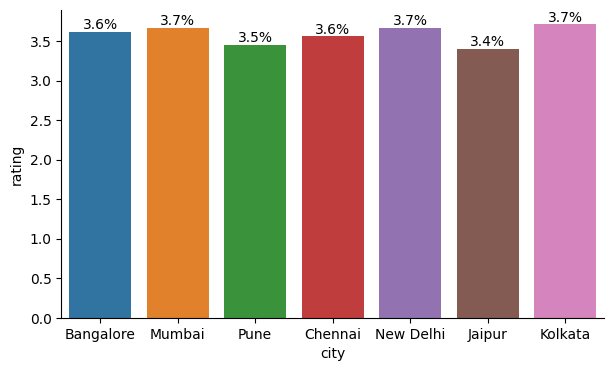

In [17]:
fig, ax = plt.subplots(figsize=(7, 4))
p = sns.barplot(x="city",y="rating",data=df_zomato_cities,order=["Bangalore","Mumbai","Pune","Chennai","New Delhi","Jaipur","Kolkata"],errorbar=None)
ax.bar_label(ax.containers[0],fmt='%.1f%%')
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)

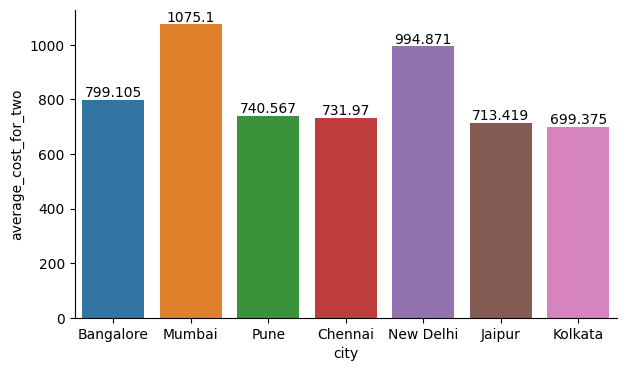

In [ ]:
fig, ax = plt.subplots(figsize=(7, 4))
sns.barplot(x="city",y="average_cost_for_two",data=df_zomato_cities,order=["Bangalore","Mumbai","Pune","Chennai","New Delhi","Jaipur","Kolkata"],errorbar=None)
ax.bar_label(ax.containers[0])
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)

(0.0, 6000.0)

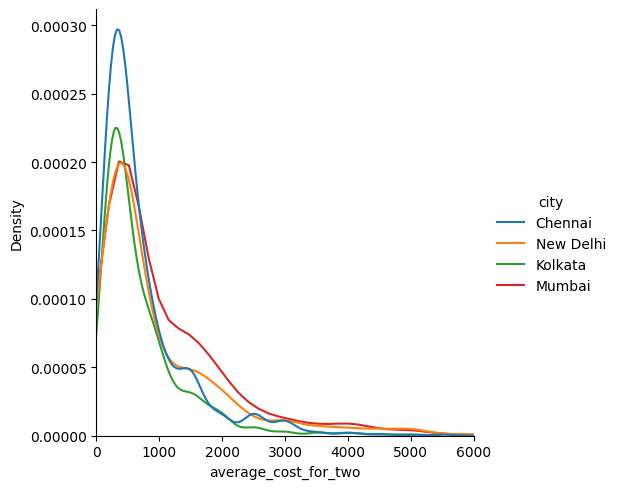

In [22]:
df_zomato_metro = df_zomato[df_zomato.city.isin(["Mumbai","Chennai","New Delhi","Kolkata"])]

sns.displot(data=df_zomato_metro, x="average_cost_for_two", hue="city", kind="kde")
plt.xlim(0,6000)

<AxesSubplot:xlabel='rating', ylabel='average_cost_for_two'>

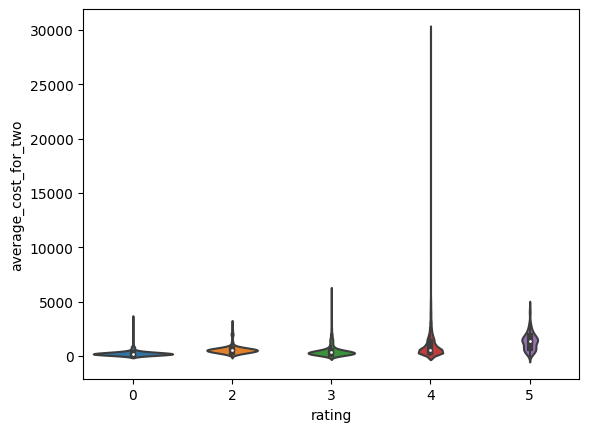

In [ ]:
#sns.displot(data=df_zomato_metro, x="rating", hue="city", kind="kde")

sns.violinplot(x=df_zomato_metro.rating,y=df_zomato_metro.average_cost_for_two)

#plt.xlim(0,5)

In [ ]:
sns.displot(data=df_zomato_metro, x="votes", hue="city", kind="kde",rug=True)

plt.xlim(0,6000)

NameError: name 'df_zomato_metro' is not defined

C:\Users\SahasraGowtham\AppData\Local\Temp\ipykernel_14064\145449947.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_zomato.average_cost_for_two,rug=True,kde_kws={"lw":3},rug_kws={"height":0.05, 'color':'xkcd:red'})


(-1000.0, 20000.0)

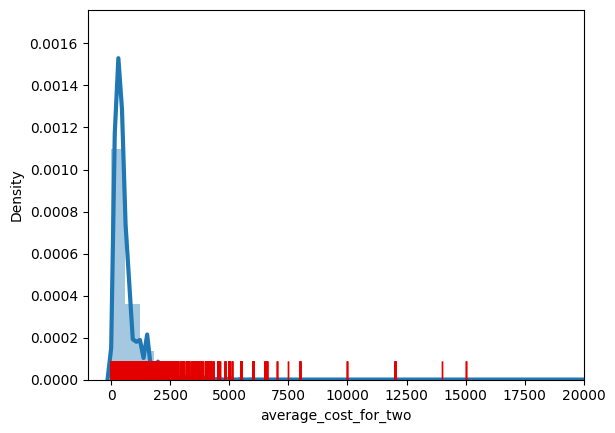

In [ ]:
sns.distplot(df_zomato.average_cost_for_two,rug=True,kde_kws={"lw":3},rug_kws={"height":0.05, 'color':'xkcd:red'})
plt.xlim(-1000,20000)

In [15]:
alt.data_transformers.disable_max_rows()
'''
alt.Chart(df_zomato_metro).mark_bar().encode(
    alt.X('aggregate_rating', bin=True),
    y='count()'
    
).properties(width=400,height=300)
alt.Chart(df_zomato_metro).mark_area().encode(
    x="votes:Q",
    y="price_range:Q",
    color="city:N"
)
'''

alt.Chart(df_zomato_metro).mark_point().encode(
    x='aggregate_rating',
    y='votes',
    color='city',
).interactive()



NameError: name 'df_zomato_metro' is not defined

In [14]:
print (df_zomato.info())
alt.data_transformers.disable_max_rows()

alt.Chart(df_zomato).mark_bar().encode(
    alt.X('price_range',bin=True),
    y='count()'
)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 55568 entries, 0 to 211942
Data columns (total 14 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   res_id                55568 non-null  int64  
 1   name                  55568 non-null  object 
 2   establishment         55568 non-null  object 
 3   city                  55568 non-null  object 
 4   cuisines              55098 non-null  object 
 5   average_cost_for_two  55568 non-null  int64  
 6   price_range           55568 non-null  int64  
 7   highlights            55568 non-null  object 
 8   aggregate_rating      55568 non-null  float64
 9   rating_text           55568 non-null  object 
 10  votes                 55568 non-null  int64  
 11  photo_count           55568 non-null  int64  
 12  metro                 55568 non-null  int32  
 13  rating                55568 non-null  int64  
dtypes: float64(1), int32(1), int64(6), object(6)
memory usage: 8.2+ MB
No

alt.Chart(...)

In [ ]:
import altair as alt

source = df_zomato_metro

brush = alt.selection(type = 'interval')
points = alt.Chart(source).mark_point().encode(
    x = 'aggregate_rating:Q',
    y = 'average_cost_for_two:Q',
    color = alt.condition(brush, 'city:N', alt.value('lightgrey'))
).add_selection(
    brush
)
bars = alt.Chart(source).mark_bar().encode(
    y = 'city:N',
    color = 'city:N',
    x = 'count(city):Q',
).transform_filter(
    brush
)

chart = points & bars
chart.display()

alt.VConcatChart(...)

In [27]:
print (df_zomato["establishment"].unique())

#'establishment' column values have extra prefix & postfix charcters (prefix ("['])). So, we need to clean up the same.
df_zomato["establishment"] = df_zomato["establishment"].apply(lambda x:x[2:-2])

print("Establishment column after cleaning up")

["['Quick Bites']" "['Casual Dining']" "['Bakery']" "['Café']" "['Dhaba']"
 "['Bhojanalya']" "['Bar']" "['Sweet Shop']" "['Fine Dining']"
 "['Food Truck']" "['Dessert Parlour']" "['Lounge']" "['Pub']"
 "['Beverage Shop']" "['Kiosk']" "['Paan Shop']" "['Confectionery']" '[]'
 "['Shack']" "['Club']" "['Food Court']" "['Mess']" "['Butcher Shop']"
 "['Microbrewery']" "['Cocktail Bar']" "['Pop up']" "['Irani Cafe']"]
Establishment column after cleaning up
['Quick Bites' 'Casual Dining' 'Bakery' 'Café' 'Dhaba' 'Bhojanalya' 'Bar'
 'Sweet Shop' 'Fine Dining' 'Food Truck' 'Dessert Parlour' 'Lounge' 'Pub'
 'Beverage Shop' 'Kiosk' 'Paan Shop' 'Confectionery' '' 'Shack' 'Club'
 'Food Court' 'Mess' 'Butcher Shop' 'Microbrewery' 'Cocktail Bar' 'Pop up'
 'Irani Cafe']


In [28]:
establishment_type = df_zomato["establishment"].unique()
print (establishment_type)

['Quick Bites' 'Casual Dining' 'Bakery' 'Café' 'Dhaba' 'Bhojanalya' 'Bar'
 'Sweet Shop' 'Fine Dining' 'Food Truck' 'Dessert Parlour' 'Lounge' 'Pub'
 'Beverage Shop' 'Kiosk' 'Paan Shop' 'Confectionery' '' 'Shack' 'Club'
 'Food Court' 'Mess' 'Butcher Shop' 'Microbrewery' 'Cocktail Bar' 'Pop up'
 'Irani Cafe']


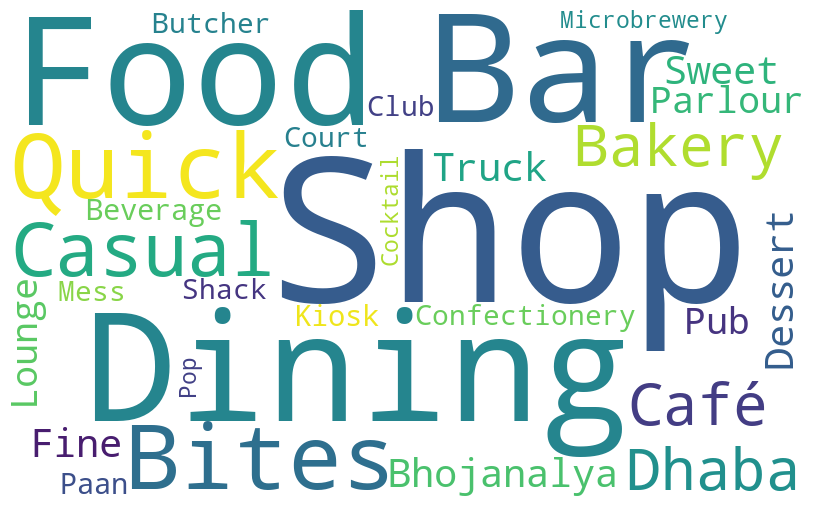

In [32]:
# https://www.geeksforgeeks.org/generating-word-cloud-python/

hl_str = ""
for i in establishment_type:
    hl_str += str(i) + " "
wordcloud = WordCloud(width = 800, height = 500, 
                background_color ='white', 
                min_font_size = 10, max_words=30).generate(hl_str) 

wordcloud.to_file("Esta_wordcloud.png")                         
#wordcloud.to_image("Esta_wordcloud.jpg")                         
plt.figure(figsize = (8, 8), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
  
plt.show()

<function matplotlib.pyplot.show(close=None, block=None)>

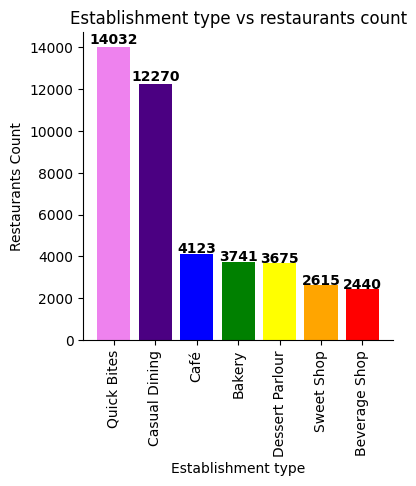

In [ ]:
df_zomato_establishments = df_zomato.groupby("establishment").count()["res_id"].sort_values(ascending=False).head(7).rename_axis("establishment").reset_index(name="restaurants_count")

labels = df_zomato_establishments.establishment
values = df_zomato_establishments.restaurants_count

fig = plt.figure(figsize=(4,4))
plt.xlabel("Establishment type")
plt.ylabel("Restaurants Count")

ax = fig.gca()
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)

#Used the VIBGYOR pattern for colors..
colors_list = ["Violet","Indigo","Blue","Green","Yellow","Orange","Red"]

graph = plt.bar(labels,values,color=colors_list)
plt.xticks(rotation=90)
plt.title("Establishment type vs restaurants count")

i=0
for p in graph:
    wid = p.get_width()
    ht = p.get_height()
    x,y = p.get_xy()
    plt.text(x+wid/2,y+(ht*1.01),  str(values[i]), ha='center',weight='bold')
    i+=1
    
plt.show

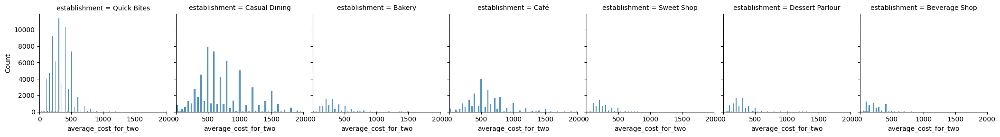

In [35]:
#fig, ax = plt.subplots(figsize=(7, 4))
df_zomato_establishment_subset = df_zomato[df_zomato.establishment.isin(["Quick Bites","Casual Dining","Café","Bakery","Dessert Parlour","Sweet Shop","Beverage Shop"])]

#p = sns.FacetGrid(df_zomato_establishment_subset, col="establishment",sharex=False)
p = sns.FacetGrid(df_zomato_establishment_subset, col="establishment")
p.map(sns.histplot,"average_cost_for_two")

for i, ax in enumerate(p.axes.flat):  # set every-other axis for testing purposes
    ax.set_xlim(0, 2001)     

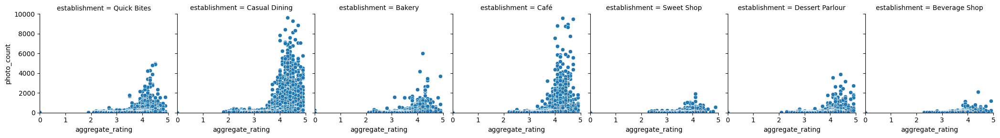

In [ ]:
g = sns.FacetGrid(df_zomato_establishment_subset, col="establishment")
g.map_dataframe(sns.scatterplot,x="aggregate_rating",y="photo_count")
for i, ax in enumerate(g.axes.flat):
    ax.set_xlim(0, 5)
    ax.set_ylim(0, 10000)
    